# DT 업무보고 - 딜러 백테스팅 환경 구축 (2020.4.10)

## 1) 환경구축 필요성
 - 정량적 분석에 기반한 트레이딩 환경
 - 집중된 환경 제공으로 시행착오를 줄이고 관련 지식 집중화. 향후 작업내용 사업단내 공유 가능

## 2) 환경설명
 - 외부 인터넷망(ADSL) 사용 : 오픈소스 라이브러리 및 공개된 시장데이터 입수 등
 - 파이썬 JupyterHub 환경 : 쉽게 바로 코딩이 가능한 환경
 - 자체개발 vs 외부 라이브러리 활용 : 필요한 부분 외부 라이브러리 활용

## 3) 진행내용
 - linux 서버 구축 : 자금결제실 프로젝트룸에 위치, ADSL 망
 - 백테스트 Template 작성 : 기본 시장DATA(국채선물 일간), 기초 전략 백테스트 코드 템플릿
 - 사용자 관리 : 요청시 딜러별 서버 계정 발급 및 권한 부여

## 4) 향후계획
 - 전략 다양화 : 전통적 퀀트 전략, AI기반 전략 연구 및 적용
 - 데이터 주기 변경 : 일중(intraday) 데이터 활용 가능하도록 기능 추가
 - 시뮬레이션 기능 : 백테스트 뿐 아니라 실시간 시장데이터를 바탕으로 모의 투자 

## 5) 템플릿 시연

한국거래소에 상장된 국고채 10년물 일별 가격DATA를 바탕으로 기초적인 몇가지 전략을 적용한 운용성과를 백테스트하는 예제입니다. 한도는 1000억이며 전략에 따라 한도의 100%씩 거래하도록 합니다. 비교할 Benchmark 는 국고채 10년물 자신으로 합니다.

적용된 전략은 아래와 같습니다.
 - Buy and Hold : 최초 거래일에 매수후 계속 보유
 - Simple Moving Average : 현재가격이 20일 이동평균을 상향돌파하면 매수, 하향돌파하면 매도
 - Moving Average Crossover : 단기(20일)이동평균선이 장기(100일)이동평균선을 상향돌파하면 매수, 하향돌파하면 매도
 - MACD : MACD가 MACD signal을 상향돌파하면 매수, 하향돌파하면 매도
 - RSI : RSI가 30% 하회시 과매도로 판단하여 매수, 70% 상회시 과매수로 판단하여 매도

---

### Importing Libraries

사용할 여러 라이브러리들을 불러옵니다.

In [2]:
%load_ext watermark
%load_ext zipline

%matplotlib inline
%config InlineBackend.figure_format = 'retina' # 그래프를 더 높은 해상도로 출력

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import zipline
from trading_calendars import get_calendar
# from yahoofinancials import YahooFinancials
import warnings

plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = [16, 9]
plt.rcParams['figure.dpi'] = 200
warnings.simplefilter(action='ignore', category=FutureWarning)

### Strategies
### 1. Buy and Hold

In [37]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 1000 --bundle krx_futures -o buy_and_hold.pkl --trading-calendar XKRX

# imports
from zipline.api import order_percent, order, record, symbol, set_benchmark
from zipline.finance import commission

# parameters
SELECTED_STOCK = 'LKTB'
# n_stocks_to_buy = 10 # order_percent 로 변경하며 주석처리

def initialize(context):
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_ordered = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))

def handle_data(context, data):
    
    # trading logic
    if not context.has_ordered:
        # placing order, negative number for sale/short
        order_percent(context.asset, 1)
        # setting up a flag for holding a position
        context.has_ordered = True
        
    # record price for further inspection
    record(price=data.current(context.asset, 'price'))

,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00000,1000.00000,0.000,0.000,...,0.0,0.0,0,NaN,1000.00000,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.005427,-0.000483,-0.174238,-0.003216,0.019419,-0.279472,-967.44348,32.55652,966.960,966.960,...,0.0,0.0,0,-11.224972,1000.00000,0.000,0.000,2,"[{'sid': Equity(1 [LKTB]), 'order_id': 'f97e93...",0.0
2018-01-04 06:30:00+00:00,0.018004,-0.002643,-0.122757,-0.005443,0.014877,0.217013,0.00000,32.55652,964.800,964.800,...,0.0,0.0,0,-10.945054,32.55652,966.960,966.960,3,[],0.0
2018-01-05 06:30:00+00:00,0.022134,-0.001443,0.065144,-0.004206,0.027164,0.588240,0.00000,32.55652,966.000,966.000,...,0.0,0.0,0,-5.166169,32.55652,964.800,964.800,4,[],0.0
2018-01-08 06:30:00+00:00,0.022737,-0.003523,0.042092,-0.006350,0.024790,0.685319,0.00000,32.55652,963.920,963.920,...,0.0,0.0,0,-8.229871,32.55652,966.000,966.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.023925,-0.006163,0.040640,-0.009071,0.024124,0.784748,0.00000,32.55652,961.280,961.280,...,0.0,0.0,0,-9.921684,32.55652,963.920,963.920,6,[],0.0
2018-01-10 06:30:00+00:00,0.032999,-0.011283,0.079966,-0.014349,0.031740,0.939025,0.00000,32.55652,956.160,956.160,...,0.0,0.0,0,-10.386582,32.55652,961.280,961.280,7,[],0.0
2018-01-11 06:30:00+00:00,0.041545,-0.007923,0.065907,-0.010886,0.042925,0.918174,0.00000,32.55652,959.520,959.520,...,0.0,0.0,0,-6.800418,32.55652,956.160,956.160,8,[],0.0
2018-01-12 06:30:00+00:00,0.039238,-0.009923,0.057365,-0.012947,0.040333,0.922684,0.00000,32.55652,957.520,957.520,...,0.0,0.0,0,-7.685432,32.55652,959.520,959.520,9,[],0.0
2018-01-15 06:30:00+00:00,0.039387,-0.013683,0.053932,-0.016823,0.040017,0.938395,0.00000,32.55652,953.760,953.760,...,0.0,0.0,0,-8.810893,32.55652,957.520,957.520,10,[],0.0


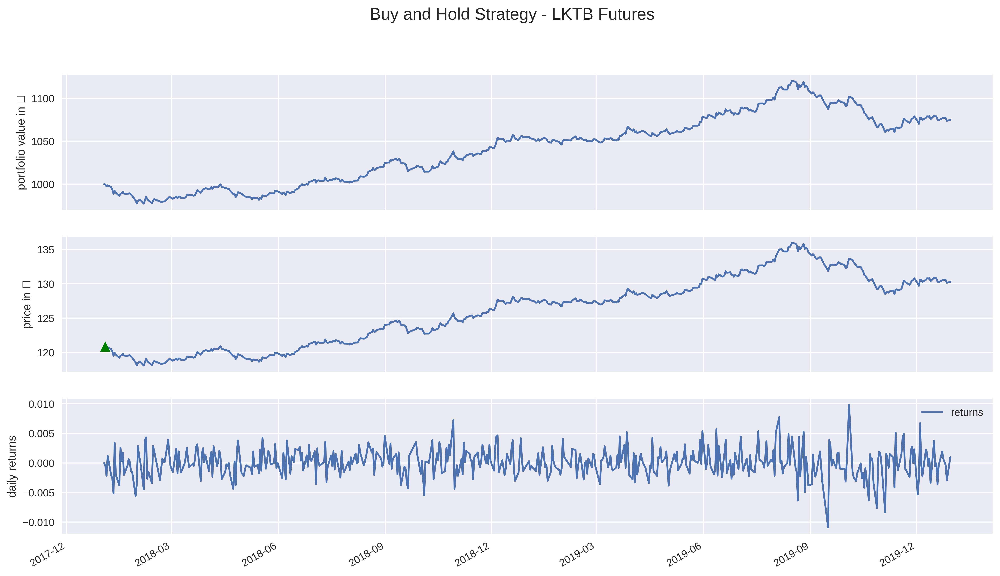

Final portfolio value (including cash): 1074.8￦


In [38]:
# read the performance summary dataframe
buy_and_hold_results = pd.read_pickle('buy_and_hold.pkl')
buy_and_hold_results.to_csv("buy_and_hold.csv")

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(buy_and_hold_results, 'Buy and Hold Strategy - LKTB Futures', '￦')
buy_and_hold_perf = qf.get_performance_summary(buy_and_hold_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,3.8%
Cumulative returns,7.5%
Annual volatility,3.8%
Sharpe ratio,1.00
Calmar ratio,0.71
Stability,0.88
Max drawdown,-5.3%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,5.34,2019-08-16,2019-11-12,NaT,NaN
1,2.27,2018-01-02,2018-02-05,2018-06-27,127
2,1.49,2018-09-10,2018-10-04,2018-10-26,35
3,1.10,2019-03-28,2019-04-17,2019-05-23,41
4,1.06,2018-12-19,2019-01-30,2019-03-25,69


Stress Events,mean,min,max
New Normal,0.02%,-1.09%,0.98%


Top 10 long positions of all time,max
sid,
LKTB,97.09%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,97.09%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


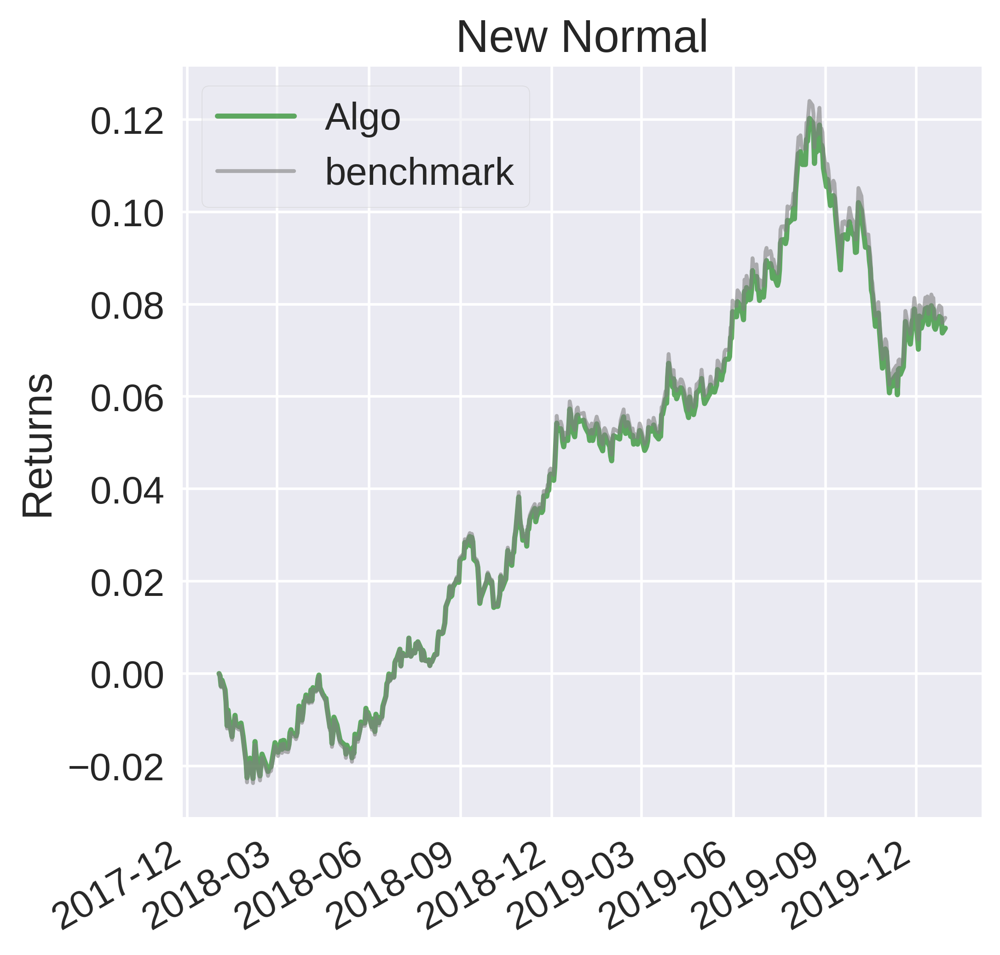

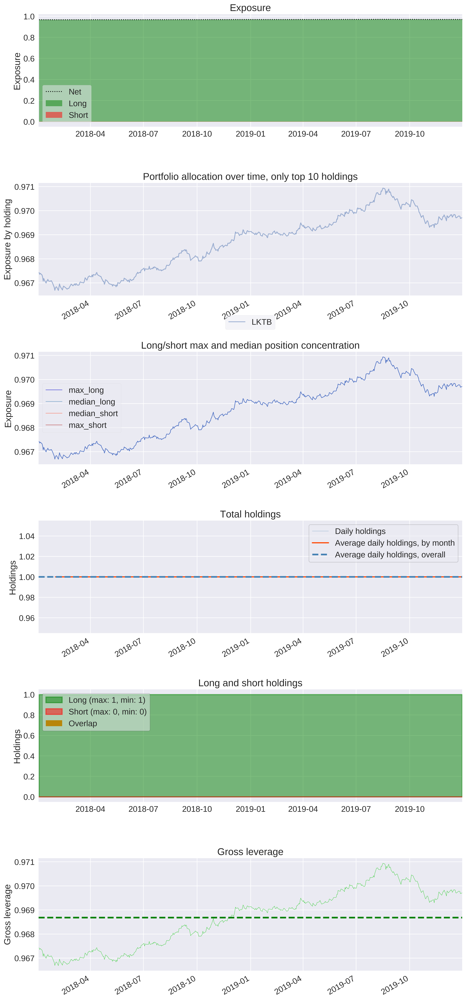

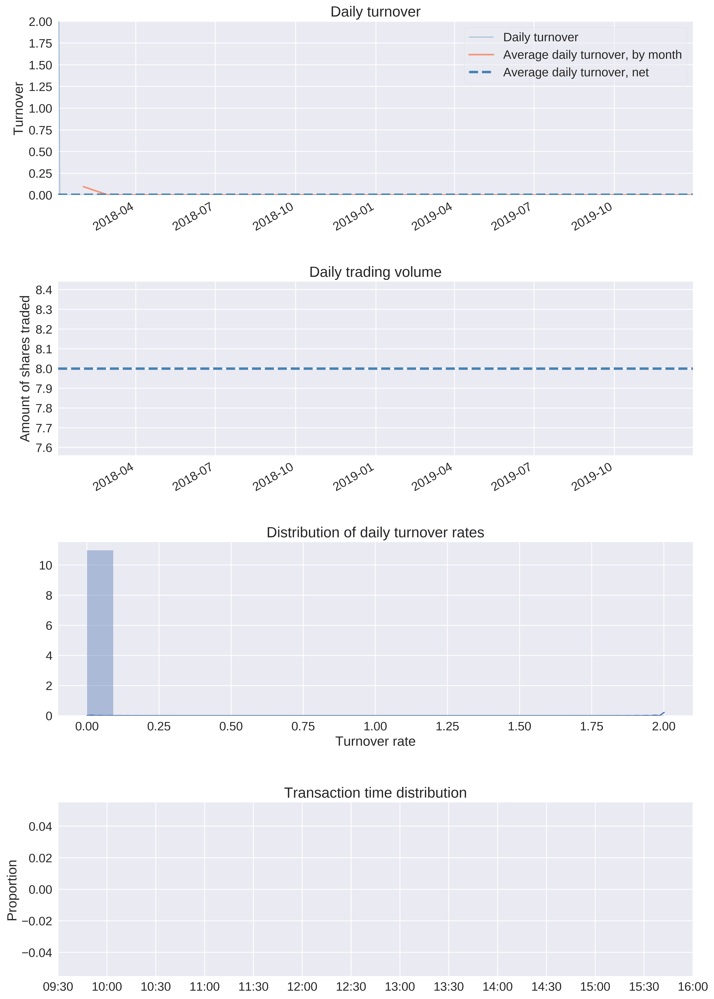

In [39]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(buy_and_hold_results)
benchmark_period_return = buy_and_hold_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### Simple Moving Average

In [40]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 1000 --bundle krx_futures -o simple_moving_average.pkl --trading-calendar XKRX

# imports 
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage

# parameters 
MA_PERIODS = 20
SELECTED_STOCK = 'LKTB'

def initialize(context):
    
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))

def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=MA_PERIODS, frequency="1d")
    ma = price_history.mean()
    
    # cross up
    if (price_history[-2] < ma) & (price_history[-1] > ma) & (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
    # cross down
    elif (price_history[-2] > ma) & (price_history[-1] < ma) & (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False

    record(price=data.current(context.asset, 'price'),
           moving_average=ma)

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.000000,0.000000,-0.006350,0.024790,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.000000,0.000000,-0.009071,0.024124,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.000000,0.000000,-0.014349,0.031740,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.000000,0.000000,-0.010886,0.042925,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.000000,0.000000,-0.012947,0.040333,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.000000,0.000000,-0.016823,0.040017,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,10,[],0.0


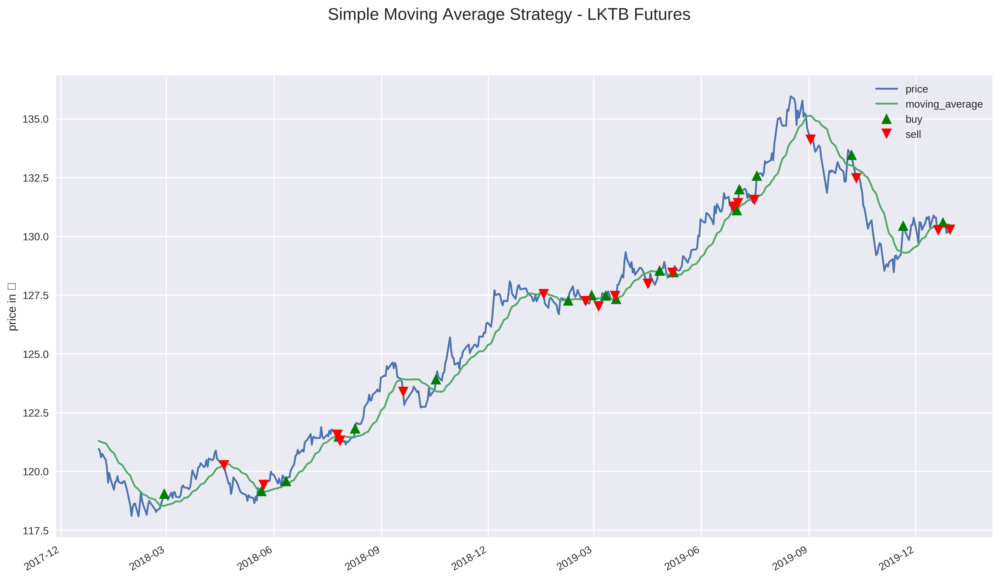

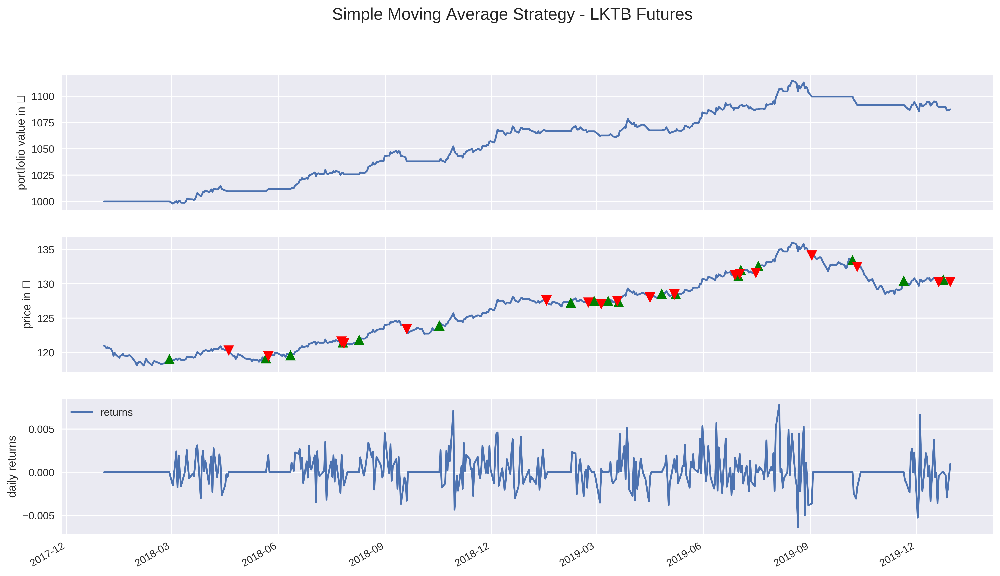

Final portfolio value (including cash): 1087.35￦


In [41]:
sma_results = pd.read_pickle('simple_moving_average.pkl')
fig, ax = plt.subplots()

# asset
sma_results[['price', 'moving_average']].plot(ax=ax)
ax.set_ylabel('price in ￦')

# mark transactions
perf_trans = sma_results.loc[[t != [] for t in sma_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, sma_results.price.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, sma_results.price.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('Simple Moving Average Strategy - LKTB Futures', fontsize=16)
plt.legend()
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(sma_results, 'Simple Moving Average Strategy - LKTB Futures', '￦')
sma_perf = qf.get_performance_summary(sma_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,4.4%
Cumulative returns,8.7%
Annual volatility,2.7%
Sharpe ratio,1.58
Calmar ratio,1.70
Stability,0.94
Max drawdown,-2.6%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,2.58,2019-08-16,2019-12-03,NaT,NaN
1,1.23,2019-03-28,2019-05-03,2019-05-29,45
2,1.02,2018-09-10,2018-10-22,2018-10-29,36
3,1.01,2018-10-29,2018-11-06,2018-11-23,20
4,1.00,2019-02-11,2019-03-18,2019-03-27,33


Stress Events,mean,min,max
New Normal,0.02%,-0.64%,0.78%


Top 10 long positions of all time,max
sid,
LKTB,97.60%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,97.60%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


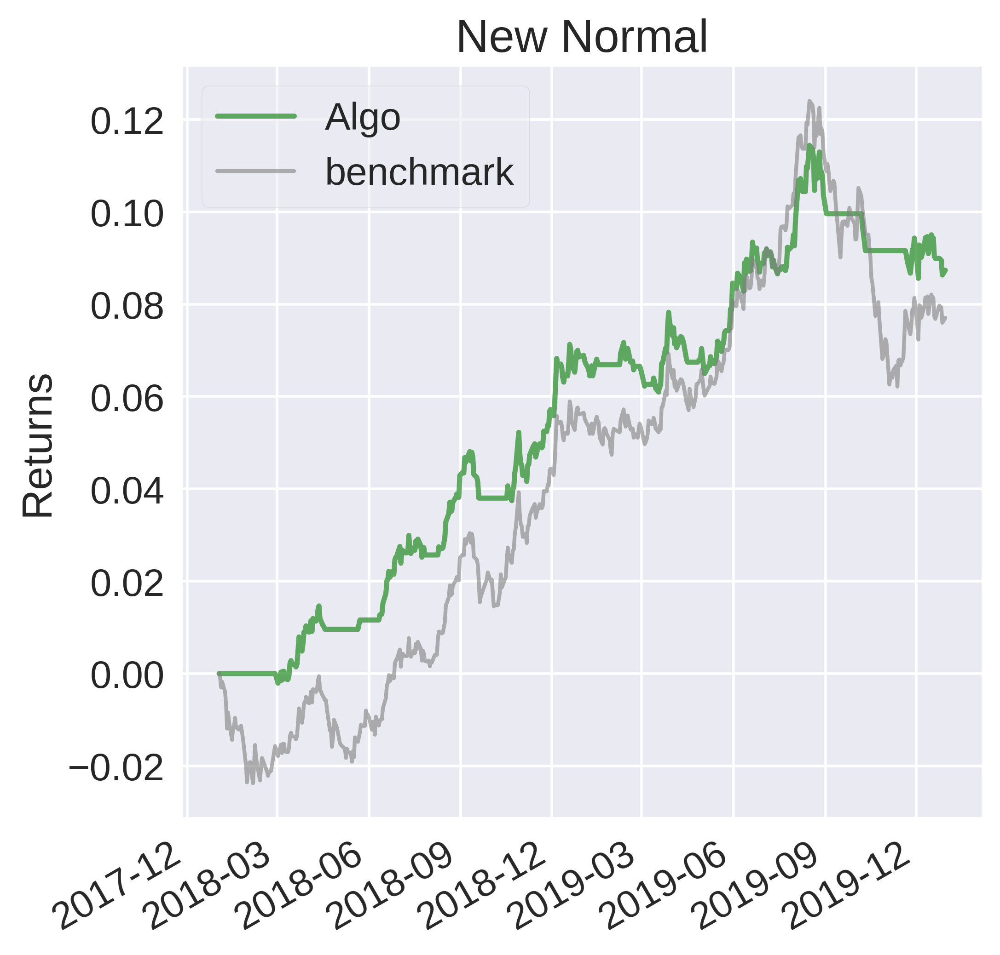

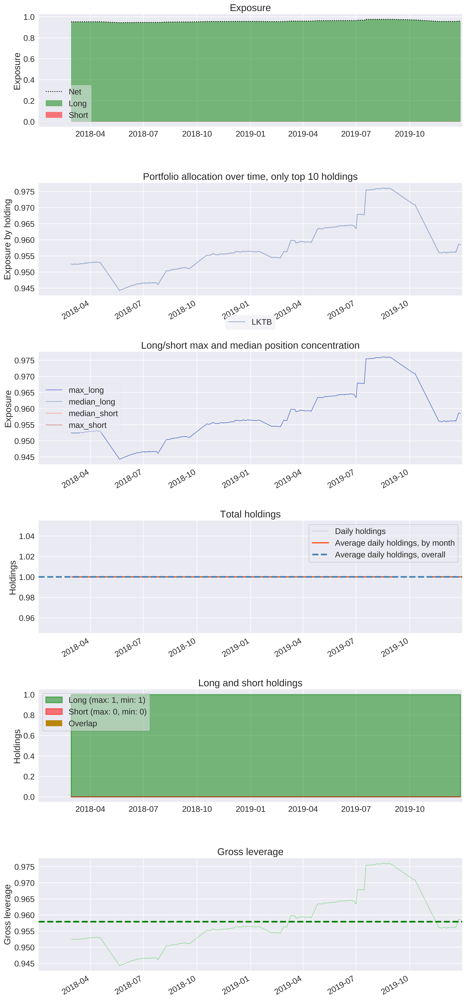

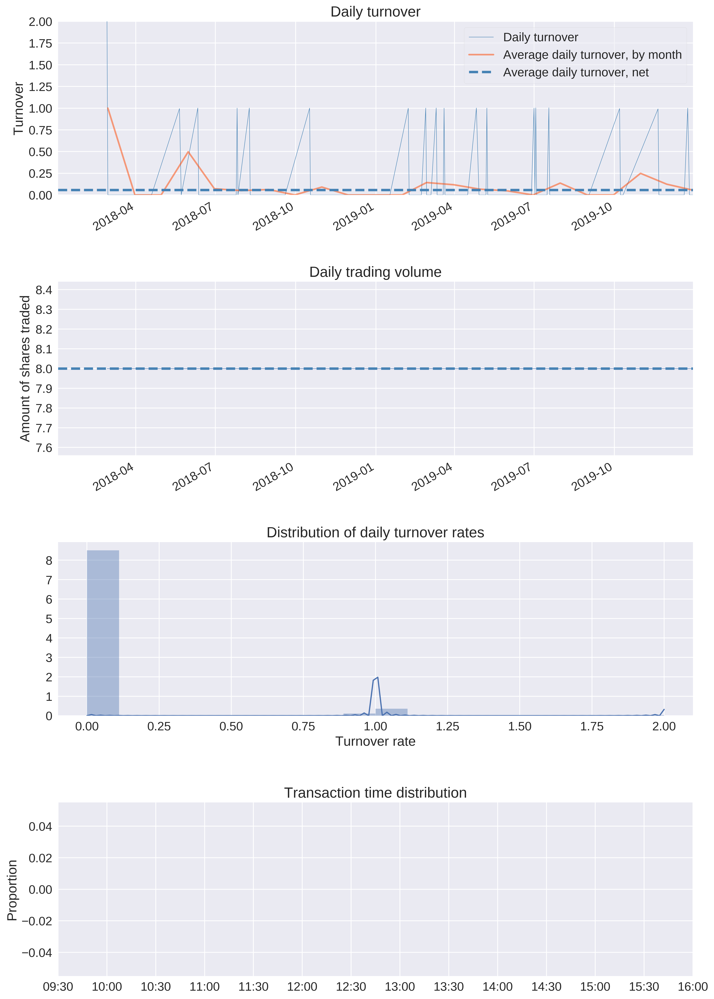

In [42]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(sma_results)
benchmark_period_return = sma_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### Moving Average Crossover

In [44]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 1000 --bundle krx_futures -o moving_average_crossover.pkl --trading-calendar XKRX

# imports 
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage

# parameters 
SELECTED_STOCK = 'LKTB'
SLOW_MA_PERIODS = 100
FAST_MA_PERIODS = 20

def initialize(context):
    
    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):

    fast_ma = data.history(context.asset, 'price', bar_count=FAST_MA_PERIODS, frequency="1d").mean()
    slow_ma = data.history(context.asset, 'price', bar_count=SLOW_MA_PERIODS, frequency="1d").mean()

    # Trading logic
    if (fast_ma > slow_ma) & (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
    elif (fast_ma < slow_ma) & (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False

    record(price=data.current(context.asset, 'price'),
           fast_ma=fast_ma,
           slow_ma=slow_ma)

,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_value,shorts_count,slow_ma,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.00000,NaN,-0.002474,NaN,NaN,0.0,1000.00,0.0,0.0,...,0.0,0,121.77320,NaN,1000.00,0.0,0.0,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.00000,0.000000,-0.003216,0.019419,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.75020,NaN,1000.00,0.0,0.0,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.00000,0.000000,-0.005443,0.014877,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.72500,NaN,1000.00,0.0,0.0,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.00000,0.000000,-0.004206,0.027164,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.70120,NaN,1000.00,0.0,0.0,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.00000,0.000000,-0.006350,0.024790,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.67910,NaN,1000.00,0.0,0.0,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.00000,0.000000,-0.009071,0.024124,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.65540,NaN,1000.00,0.0,0.0,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.00000,0.000000,-0.014349,0.031740,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.62750,NaN,1000.00,0.0,0.0,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.00000,0.000000,-0.010886,0.042925,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.60210,NaN,1000.00,0.0,0.0,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.00000,0.000000,-0.012947,0.040333,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.57210,NaN,1000.00,0.0,0.0,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.00000,0.000000,-0.016823,0.040017,0.000000,0.0,1000.00,0.0,0.0,...,0.0,0,121.53780,NaN,1000.00,0.0,0.0,10,[],0.0


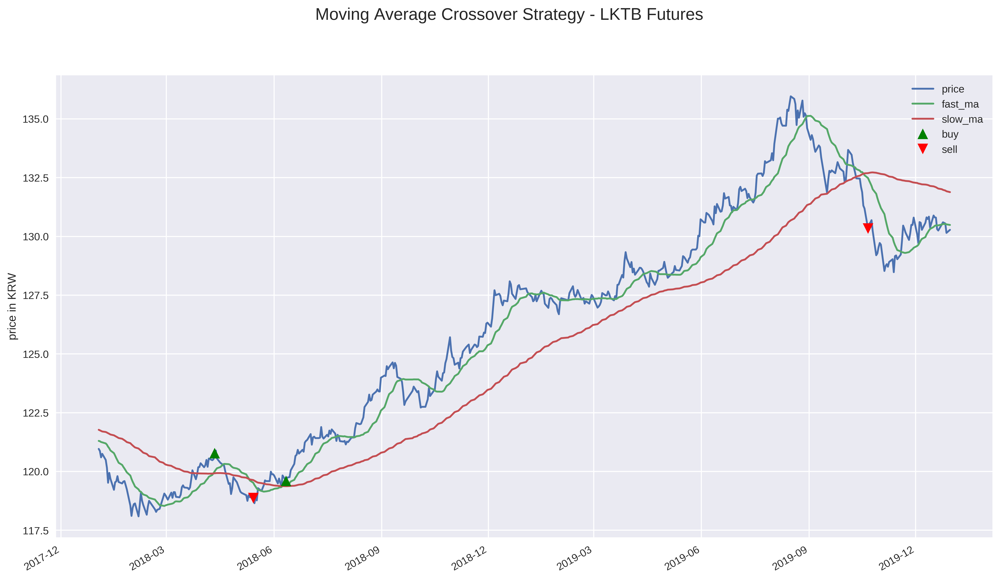

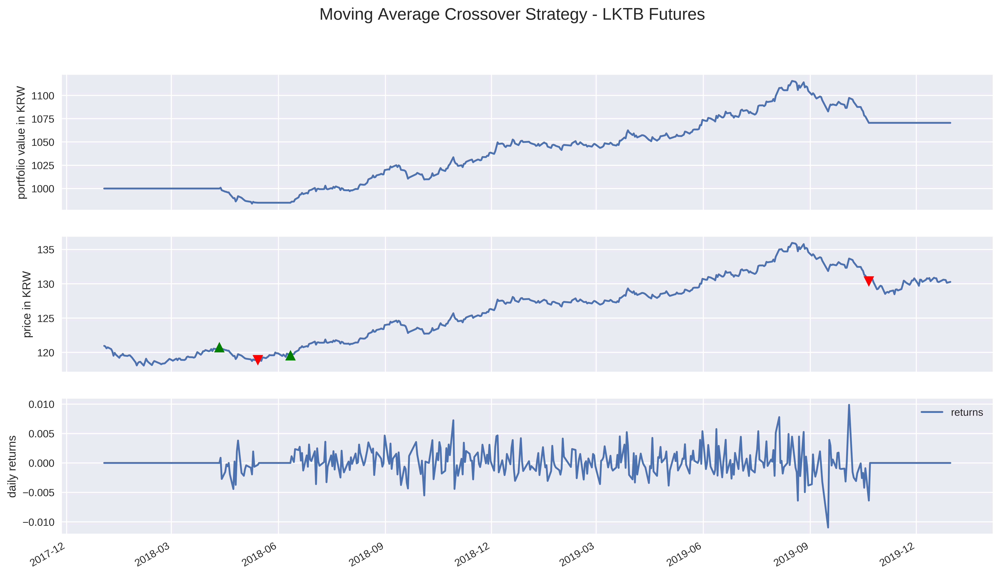

Final portfolio value (including cash): 1070.56KRW


In [47]:
mac_results = pd.read_pickle('moving_average_crossover.pkl')
fig, ax = plt.subplots()

# asset
mac_results[['price', 'fast_ma', 'slow_ma']].plot(ax=ax)
ax.set_ylabel('price in KRW')

# mark transactions
perf_trans = mac_results.loc[[t != [] for t in mac_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, mac_results.price.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, mac_results.price.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('Moving Average Crossover Strategy - LKTB Futures', fontsize=16)
plt.legend()
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(mac_results, 'Moving Average Crossover Strategy - LKTB Futures', 'KRW')
mac_perf = qf.get_performance_summary(mac_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,3.6%
Cumulative returns,7.1%
Annual volatility,3.2%
Sharpe ratio,1.12
Calmar ratio,0.88
Stability,0.86
Max drawdown,-4.0%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,4.04,2019-08-16,2019-10-21,NaT,NaN
1,1.71,2018-04-12,2018-05-09,2018-07-11,65
2,1.50,2018-09-10,2018-10-04,2018-10-26,35
3,1.11,2019-03-28,2019-04-17,2019-05-23,41
4,1.06,2018-12-19,2019-01-30,2019-03-25,69


Stress Events,mean,min,max
New Normal,0.01%,-1.10%,0.99%


Top 10 long positions of all time,max
sid,
LKTB,97.50%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,97.50%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


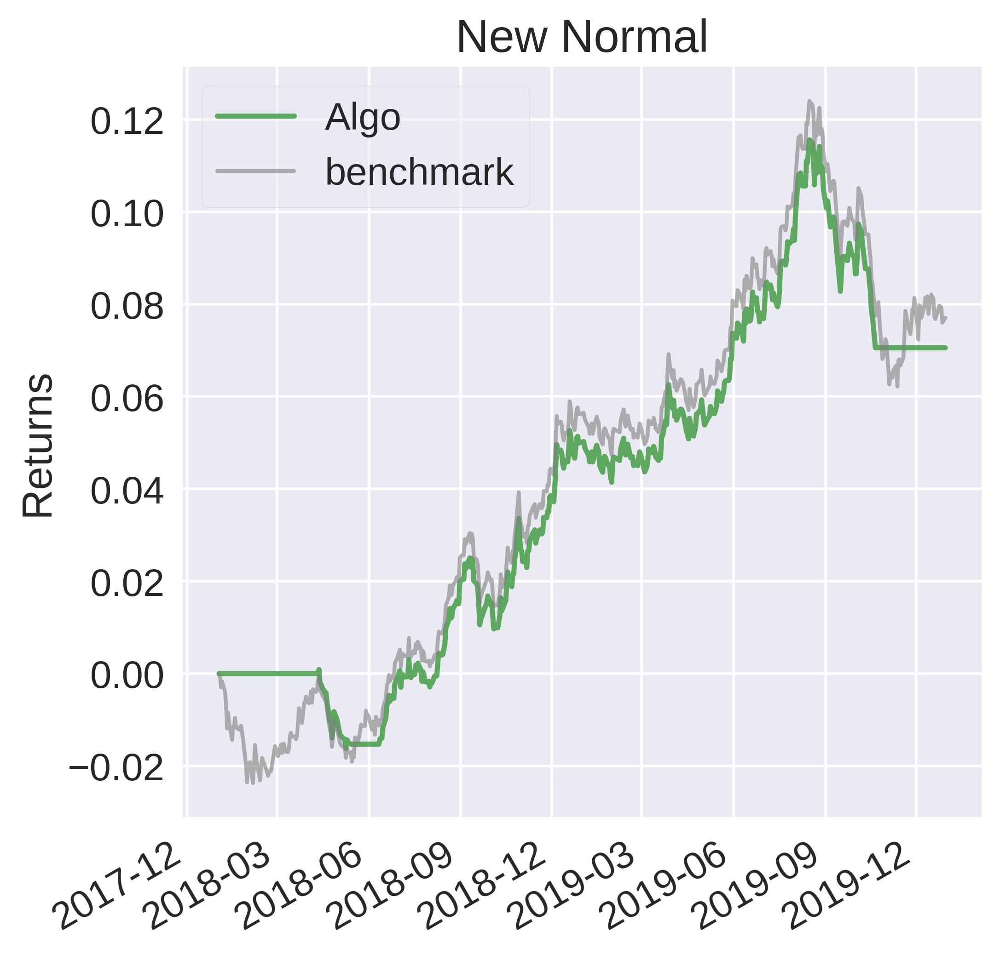

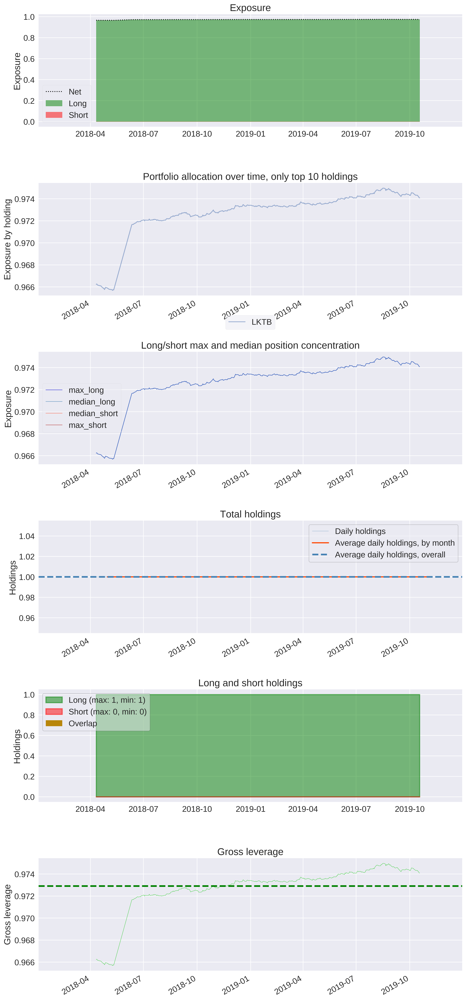

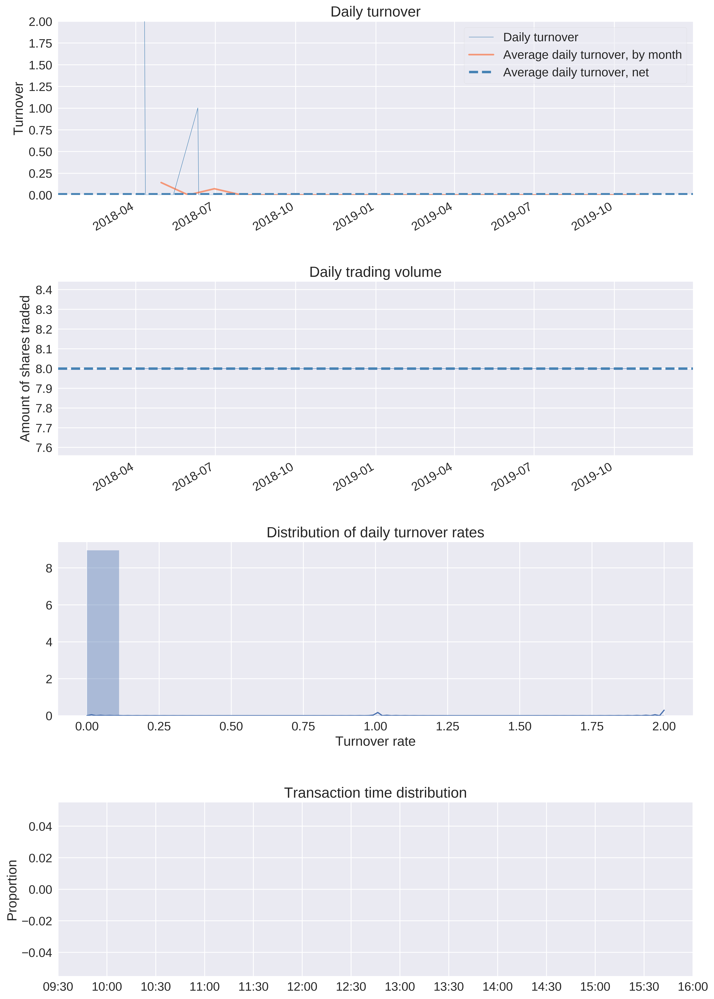

In [46]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(mac_results)
benchmark_period_return = mac_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### MACD

In [48]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 1000 --bundle krx_futures -o macd.pkl --trading-calendar XKRX

# imports ----
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage
import matplotlib.pyplot as plt
import talib as ta

# parameters ----
SELECTED_STOCK = 'LKTB'

 #initialize the strategy 
def initialize(context):

    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=34, frequency="1d")
    macd, macdsignal, macdhist = ta.MACD(price_history, 12, 26, 9) 
    
    if (macdsignal[-1] < macd[-1]) and (not context.has_position):
        order_percent(context.asset, 1.0)
        context.has_position = True
        
    if (macdsignal[-1] > macd[-1]) and (context.has_position):
        order_target(context.asset, 0)
        context.has_position = False
        
    record(macd =  macd[-1], macdsignal = macdsignal[-1], macdhist = macdhist[-1], price=price_history[-1]) 

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,4,[],0.0
2018-01-08 06:30:00+00:00,0.000000,0.000000,0.000000,-0.006350,0.024790,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.000000,0.000000,0.000000,-0.009071,0.024124,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,6,[],0.0
2018-01-10 06:30:00+00:00,0.000000,0.000000,0.000000,-0.014349,0.031740,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,7,[],0.0
2018-01-11 06:30:00+00:00,0.000000,0.000000,0.000000,-0.010886,0.042925,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,8,[],0.0
2018-01-12 06:30:00+00:00,0.000000,0.000000,0.000000,-0.012947,0.040333,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,9,[],0.0
2018-01-15 06:30:00+00:00,0.000000,0.000000,0.000000,-0.016823,0.040017,0.000000,0.00,1000.00,0.000,0.000,...,0.0,0.0,0,NaN,1000.00,0.000,0.000,10,[],0.0


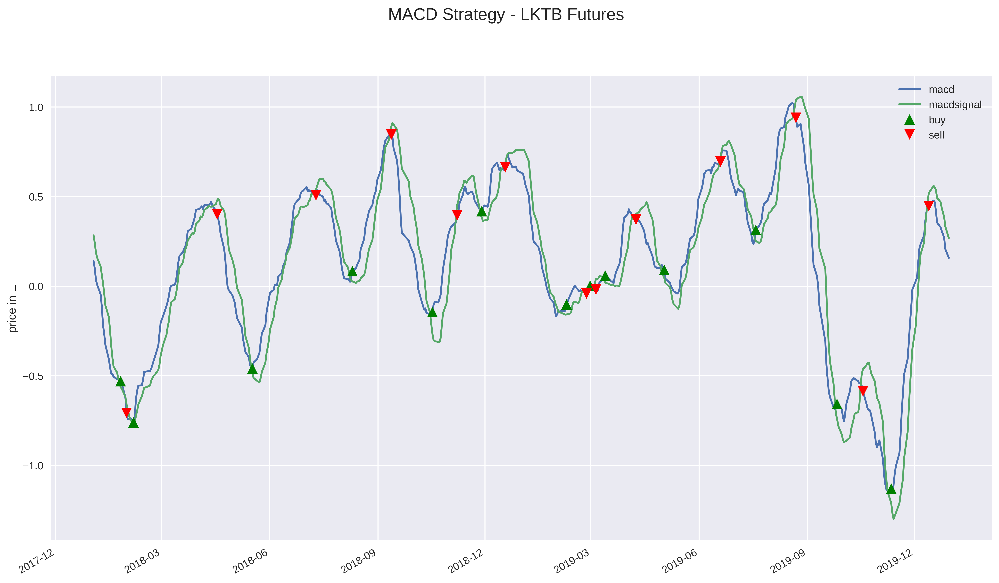

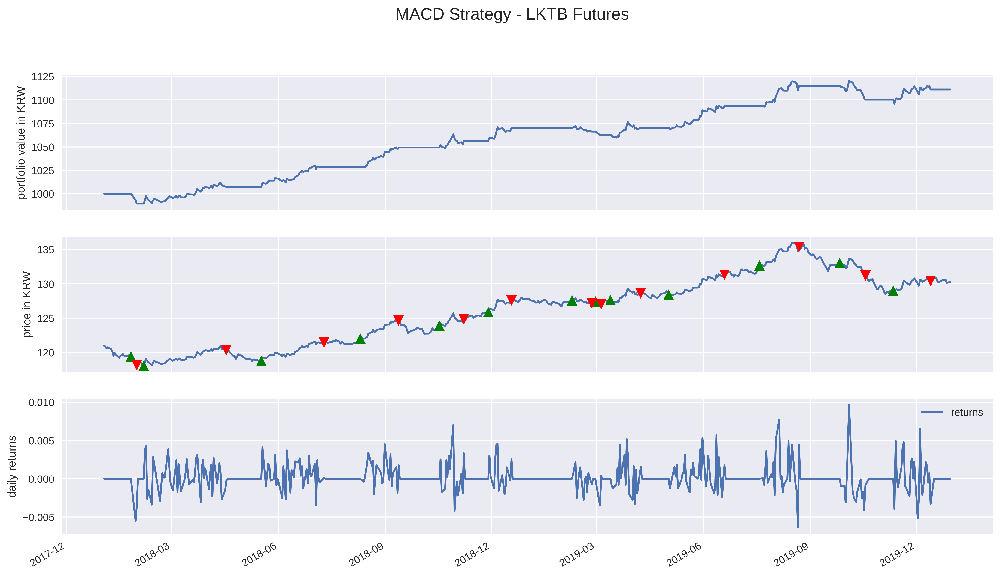

Final portfolio value (including cash): 1111.12KRW


In [50]:
macd_results = pd.read_pickle('macd.pkl')

fig, ax = plt.subplots()

# asset
macd_results[['macd', 'macdsignal']].plot(ax=ax)
ax.set_ylabel('price in ￦')

# mark transactions
perf_trans = macd_results.loc[[t != [] for t in macd_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, macd_results.macd.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, macd_results.macd.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('MACD Strategy - LKTB Futures', fontsize=16)
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(macd_results, 'MACD Strategy - LKTB Futures', 'KRW')
macd_perf = qf.get_performance_summary(macd_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,5.6%
Cumulative returns,11.1%
Annual volatility,2.8%
Sharpe ratio,1.98
Calmar ratio,2.56
Stability,0.96
Max drawdown,-2.2%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,2.17,2019-10-04,2019-11-12,NaT,NaN
1,1.15,2019-02-11,2019-03-18,2019-03-27,33
2,1.05,2018-01-25,2018-01-30,2018-03-15,36
3,1.00,2018-10-29,2018-11-06,2018-12-05,28
4,0.93,2019-08-16,2019-10-01,2019-10-04,36


Stress Events,mean,min,max
New Normal,0.02%,-0.64%,0.97%


Top 10 long positions of all time,max
sid,
LKTB,97.13%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,97.13%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


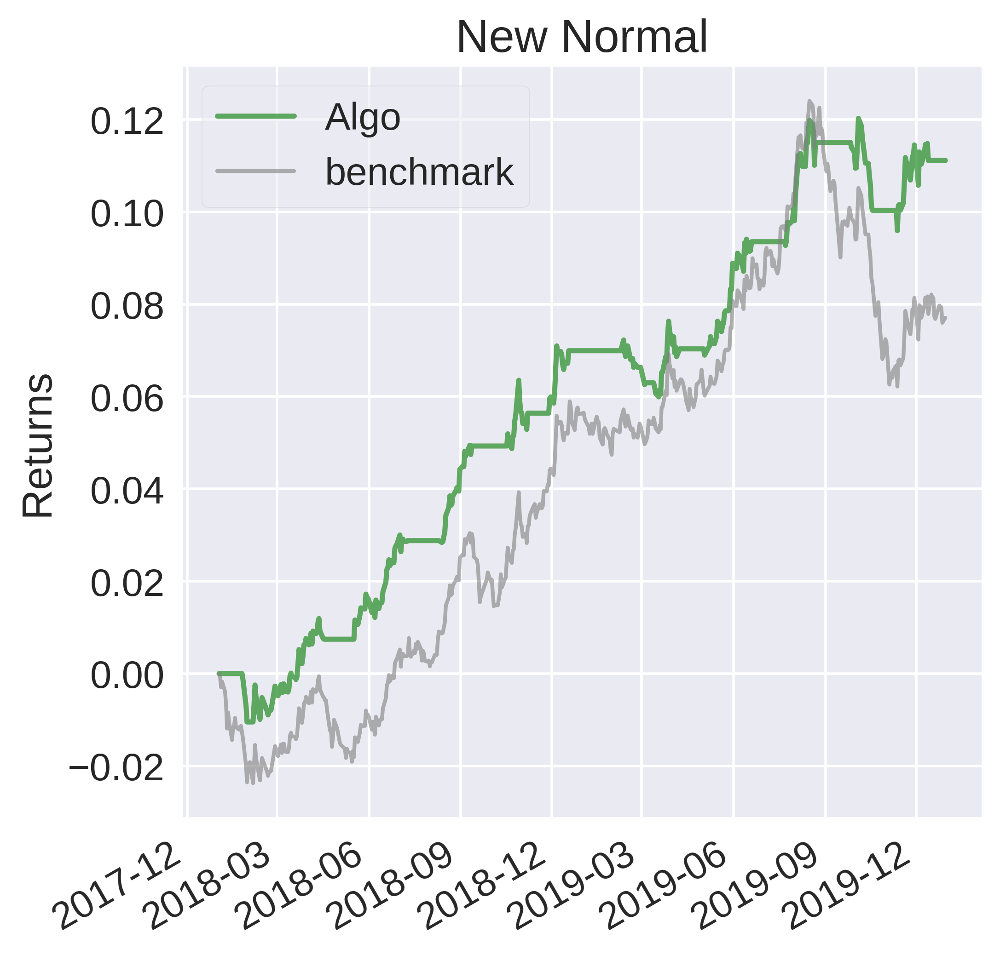

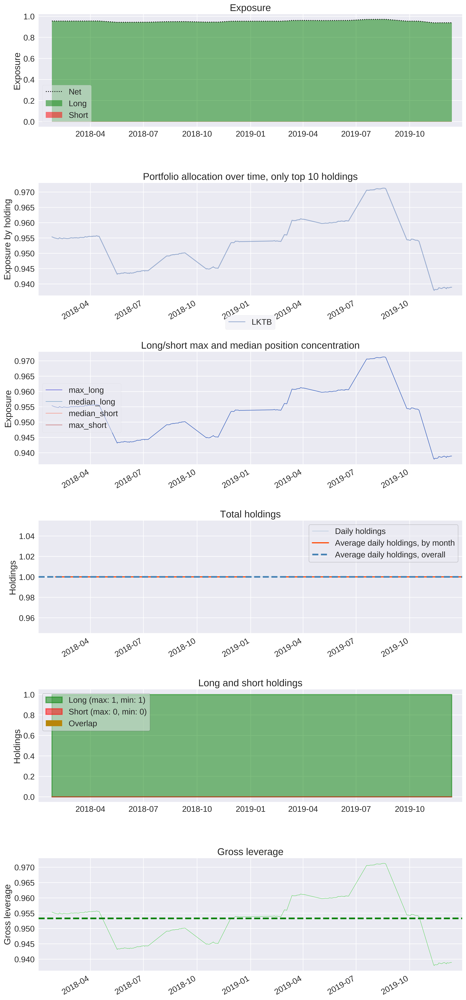

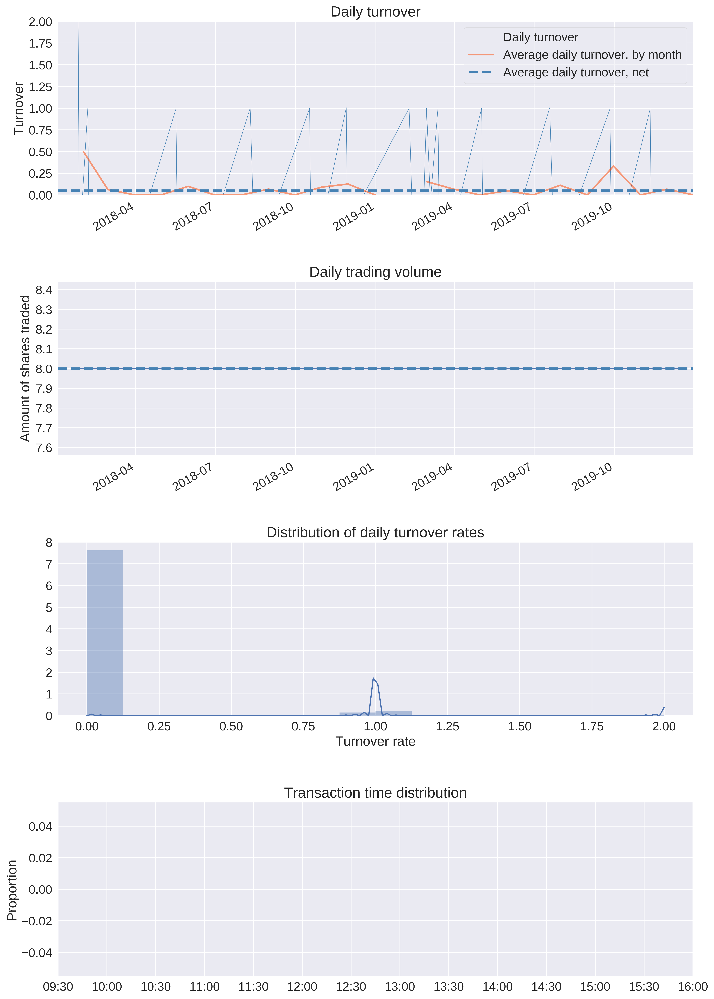

In [51]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(macd_results)
benchmark_period_return = macd_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### RSI

In [52]:
%%zipline --start 2018-1-2 --end 2019-12-30 --capital-base 1000 --bundle krx_futures -o rsi.pkl --trading-calendar XKRX

# imports ----
from zipline.api import order_percent, order, record, symbol, set_benchmark, set_slippage, order_target
from zipline.finance import commission, slippage
import matplotlib.pyplot as plt
import talib as ta

# parameters ----
SELECTED_STOCK = 'LKTB'
UPPER = 70
LOWER = 30
RSI_PERIOD = 14

#initialize the strategy 
def initialize(context):

    set_benchmark(symbol('LKTB'))
    context.asset = symbol(SELECTED_STOCK)
    context.has_position = False
    context.set_commission(commission.PerShare(cost=0.0, min_trade_cost=0))
    context.set_slippage(slippage.FixedSlippage(spread=0))
    
def handle_data(context, data):
    
    price_history = data.history(context.asset, fields="price", bar_count=RSI_PERIOD+1, frequency="1d")
    rsi = ta.RSI(price_history, timeperiod=RSI_PERIOD)
    
    if rsi[-1] < LOWER and not context.has_position:
        order_percent(context.asset, 1.0)
        context.has_position = True
      
    if rsi[-1] > UPPER and context.has_position:
        order_target(context.asset, 0)
        context.has_position = False
     
    record(rsi=rsi[-1], price=price_history[-1]) 

/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:704: RuntimeWarning: invalid value encountered in true_divide
  out=out,
/opt/conda/envs/backtest/lib/python3.5/site-packages/empyrical/stats.py:790: RuntimeWarning: invalid value encountered in true_divide
  np.divide(average_annual_return, annualized_downside_risk, out=out)


,algo_volatility,algorithm_period_return,alpha,benchmark_period_return,benchmark_volatility,beta,capital_used,ending_cash,ending_exposure,ending_value,...,short_exposure,short_value,shorts_count,sortino,starting_cash,starting_exposure,starting_value,trading_days,transactions,treasury_period_return
2018-01-02 06:30:00+00:00,NaN,0.000000,NaN,-0.002474,NaN,NaN,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,1,[],0.0
2018-01-03 06:30:00+00:00,0.000000,0.000000,0.000000,-0.003216,0.019419,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,2,[],0.0
2018-01-04 06:30:00+00:00,0.000000,0.000000,0.000000,-0.005443,0.014877,0.000000,0.00,1000.000,0.000,0.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,3,[],0.0
2018-01-05 06:30:00+00:00,0.000000,0.000000,0.000000,-0.004206,0.027164,0.000000,-966.00,34.000,966.000,966.000,...,0.0,0.0,0,NaN,1000.000,0.000,0.000,4,"[{'sid': Equity(1 [LKTB]), 'order_id': '7a1b9d...",0.0
2018-01-08 06:30:00+00:00,0.014767,-0.002080,-0.044605,-0.006350,0.024790,0.187852,0.00,34.000,963.920,963.920,...,0.0,0.0,0,-7.099296,34.000,966.000,966.000,5,[],0.0
2018-01-09 06:30:00+00:00,0.019576,-0.004720,-0.047627,-0.009071,0.024124,0.394669,0.00,34.000,961.280,961.280,...,0.0,0.0,0,-9.100221,34.000,963.920,963.920,6,[],0.0
2018-01-10 06:30:00+00:00,0.031665,-0.009840,0.051382,-0.014349,0.031740,0.783086,0.00,34.000,956.160,956.160,...,0.0,0.0,0,-9.633361,34.000,961.280,961.280,7,[],0.0
2018-01-11 06:30:00+00:00,0.039827,-0.006480,0.079509,-0.010886,0.042925,0.824802,0.00,34.000,959.520,959.520,...,0.0,0.0,0,-5.912994,34.000,956.160,956.160,8,[],0.0
2018-01-12 06:30:00+00:00,0.037795,-0.008480,0.065196,-0.012947,0.040333,0.832357,0.00,34.000,957.520,957.520,...,0.0,0.0,0,-6.944749,34.000,959.520,959.520,9,[],0.0
2018-01-15 06:30:00+00:00,0.038396,-0.012240,0.058517,-0.016823,0.040017,0.862924,0.00,34.000,953.760,953.760,...,0.0,0.0,0,-8.222497,34.000,957.520,957.520,10,[],0.0


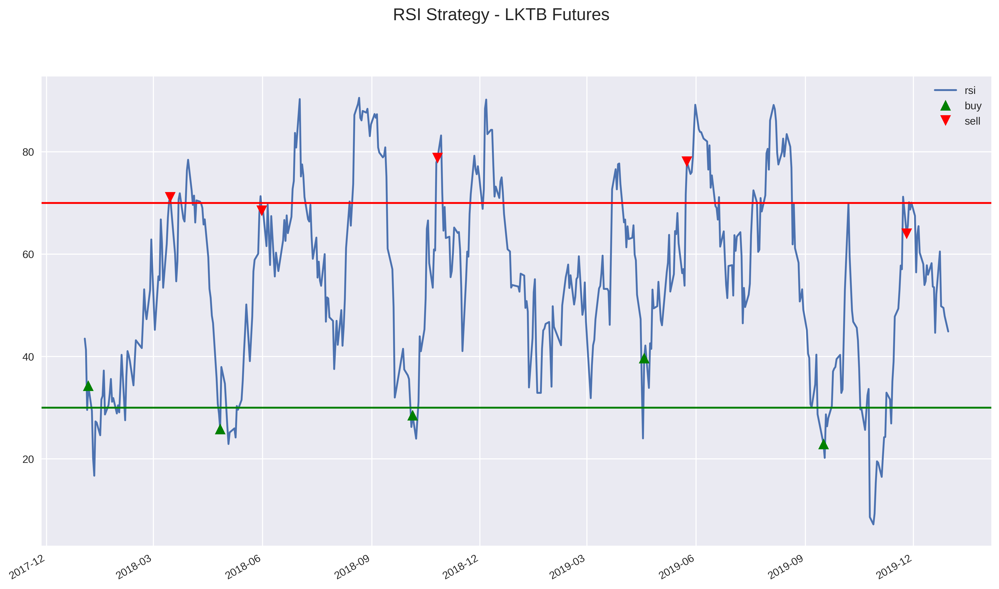

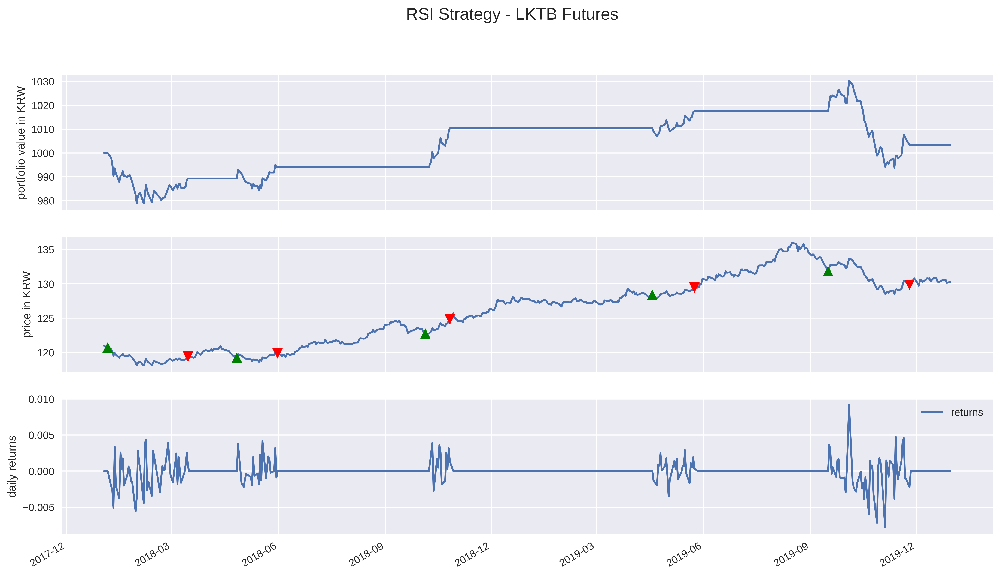

Final portfolio value (including cash): 1003.4KRW


In [53]:
rsi_results = pd.read_pickle('rsi.pkl')

#fig, ax = plt.subplots(1, 1, sharex=True, figsize=[16, 9])
fig, ax = plt.subplots()

# asset
rsi_results[['rsi']].plot(ax=ax)
ax.axhline(y=70, color='r')
ax.axhline(y=30, color='g')

# mark transactions
perf_trans = rsi_results.loc[[t != [] for t in rsi_results.transactions]]
buys = perf_trans.loc[[t[0]['amount'] > 0 for t in perf_trans.transactions]]
sells = perf_trans.loc[[t[0]['amount'] < 0 for t in perf_trans.transactions]]
ax.plot(buys.index, rsi_results.rsi.loc[buys.index], '^', markersize=10, color='g', label='buy')
ax.plot(sells.index, rsi_results.rsi.loc[sells.index], 'v', markersize=10, color='r', label='sell')
ax.legend()

fig.suptitle('RSI Strategy - LKTB Futures', fontsize=16)
plt.show()

# import helper functions 
import qf_helper_functions as qf

qf.visualize_results(rsi_results, 'RSI Strategy - LKTB Futures', 'KRW')
rsi_perf = qf.get_performance_summary(rsi_results.returns)

Start date,2018-01-02
End date,2019-12-30
Total months,23
,Backtest
Annual return,0.2%
Cumulative returns,0.3%
Annual volatility,2.2%
Sharpe ratio,0.09
Calmar ratio,0.05
Stability,0.60
Max drawdown,-3.5%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,3.53,2019-10-04,2019-11-12,NaT,NaN
1,2.13,2018-01-05,2018-02-05,2018-10-11,200
2,0.57,2019-09-25,2019-10-01,2019-10-04,8
3,0.47,2019-04-30,2019-05-03,2019-05-16,13
4,0.33,2019-04-18,2019-04-22,2019-04-25,6


Stress Events,mean,min,max
New Normal,0.00%,-0.78%,0.92%


Top 10 long positions of all time,max
sid,
LKTB,98.80%


Top 10 short positions of all time,max
sid,


Top 10 positions of all time,max
sid,
LKTB,98.80%


/opt/conda/envs/backtest/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


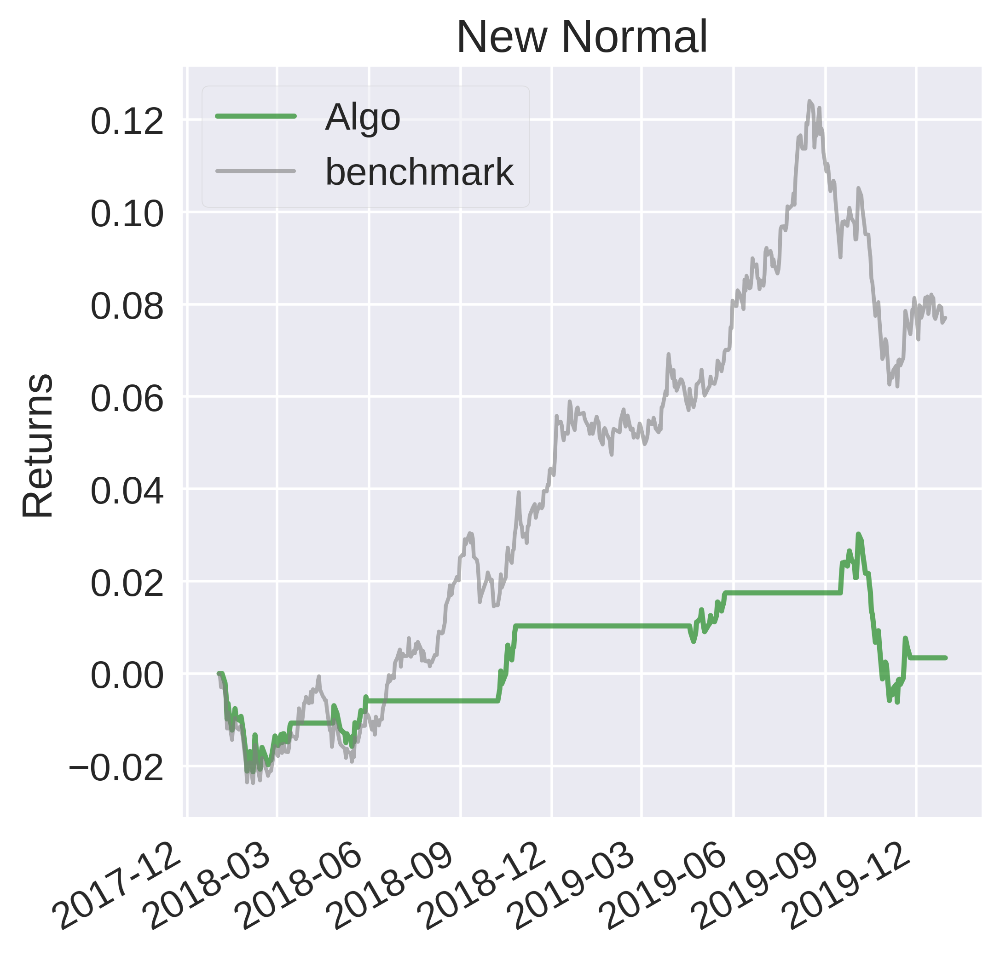

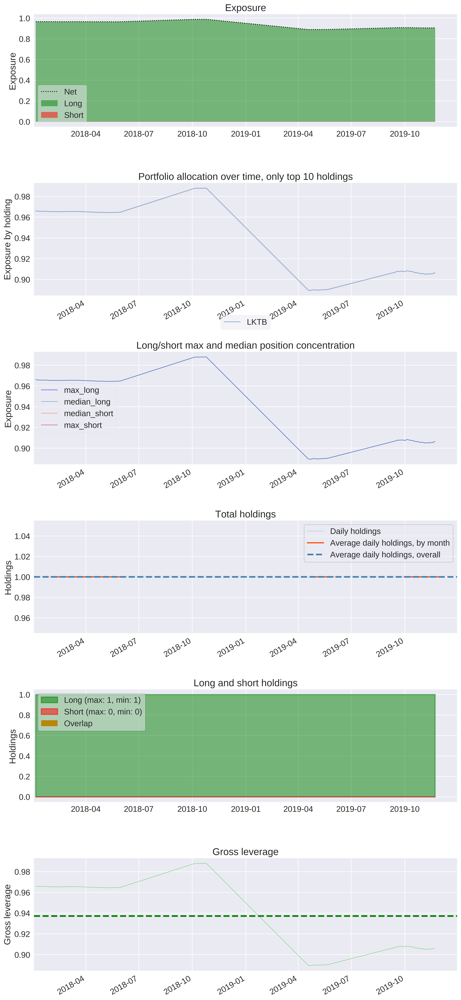

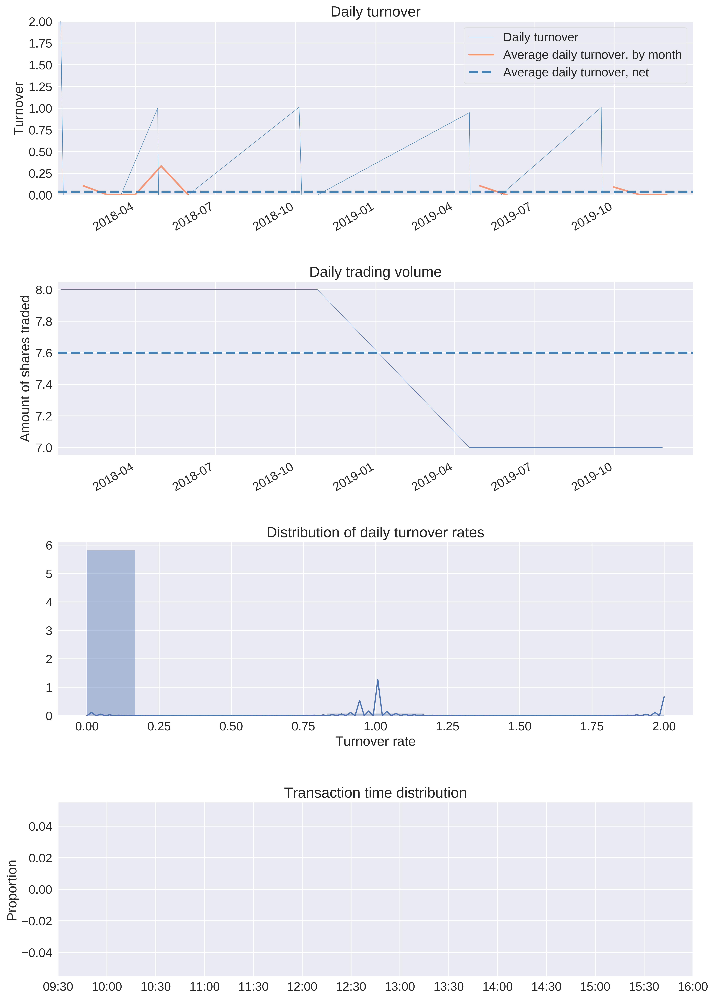

In [54]:
import pyfolio as pf
returns, positions, transactions = pf.utils.extract_rets_pos_txn_from_zipline(rsi_results)
benchmark_period_return = rsi_results['benchmark_period_return']
# Convert benchmark returns to daily returns
#daily_returns = (1 + benchmark_period_return) / (1 + benchmark_period_return.shift()) - 1
daily_benchmark_returns = np.exp(np.log(benchmark_period_return + 1.0).diff()) - 1
sheets = pf.create_full_tear_sheet(returns, positions=positions, transactions=transactions, benchmark_rets=daily_benchmark_returns)

### Evaluating the performance

In [56]:
perf_df = pd.DataFrame({'1)Buy and Hold': buy_and_hold_perf,
                        '2)Simple Moving Average': sma_perf,
                        '3)Moving Average Crossover': mac_perf,
                        '4)MACD': macd_perf,
                        '5)RSI': rsi_perf})
perf_df.transpose()

,annual_volatility,annualized_returns,cumulative_returns,max_drawdown,sharpe_ratio,sortino_ratio
1)Buy and Hold,0.037891,0.037793,0.074797,-0.053424,0.998006,1.487499
2)Simple Moving Average,0.027419,0.044010,0.087352,-0.025844,1.584551,2.625390
3)Moving Average Crossover,0.031708,0.035687,0.070560,-0.040373,1.121773,1.749610
4)MACD,0.027563,0.055685,0.111120,-0.021717,1.979959,3.515536
5)RSI,0.021691,0.001746,0.003397,-0.035339,0.091229,0.128453


4) MACD 전략이 연환산 수익율 5.6%, 최대 drawdown -2.2% 및 샤프지수 등으로 종합 우수함.